In [11]:
#load packages

import numpy as np
import matplotlib.pyplot as pl
import h5py
import batman
import emcee
import george
import corner
import os
import glob
import sys
import io
import warnings
import logging
import ultranest
import pandas as pd
import pickle

from scipy import special
from scipy.stats import binned_statistic

In [12]:
# Define the root directory containing all planet light curve folders
root_dir = "trappist_all_prepared_light_curve_files/"

# Only load TRAPPIST-1e_2023-06-22
selected_keys = ["TRAPPIST-1e-1b_2025-10-29"]

file_list = []
for key in selected_keys:
    planet, date = key.split("_", 1)
    files = sorted(glob.glob(os.path.join(root_dir, planet, date, "prepared_light_curve.h5")))
    file_list.extend(files)

print(f"Found {len(file_list)} light curve files for selected keys: {selected_keys}")

# Load all data into a dictionary, removing NaNs from wavelength and corresponding fluxes
data_dict_flares_new = {}
for fn in file_list:
    planet = os.path.basename(os.path.dirname(os.path.dirname(fn)))
    date = os.path.basename(os.path.dirname(fn))
    key = f"{planet}_{date}"
    with h5py.File(fn, 'r') as f:
        mask = ~np.isnan(f['wavelength'][:])
        data_dict_flares_new[key] = {
            'bjd': f['bjd'][:],
            'bjd_binned': f['bjd_binned'][:],
            'flux': f['flux'][:, mask],
            'flux_binned': f['flux_binned'][:, mask],
            'flux_err': f['flux_err'][:, mask],
            'flux_err_binned': f['flux_err_binned'][:, mask],
            'it_index': f['it_index'][:],
            'it_index_non_binned': f['it_index_non_binned'][:],
            'oot_index': f['oot_index'][:],
            'oot_index_non_binned': f['oot_index_non_binned'][:],
            'wavelength': f['wavelength'][mask],
            'white_binned': f['white_binned'][:],
            'white_err_binned': f['white_err_binned'][:]
        }


Found 1 light curve files for selected keys: ['TRAPPIST-1e-1b_2025-10-29']


In [13]:
#Define FLARE MODEL

from scipy import special
from scipy.stats import binned_statistic

def flare_eqn(t,tpeak,fwhm,ampl):
    '''
    The equation that defines the shape for the Continuous Flare Model
    '''
    #Values were fit & calculated using MCMC 256 walkers and 30000 steps 
    #From Tovar Mendoza et al. (2022) DOI 10.3847/1538-3881/ac6fe6 (Llamaradas Estelares: Modeling the Morphology of White-Light Flares)

    A,B,C,D1,D2,f1 = [0.9687734504375167,-0.251299705922117,0.22675974948468916,
                      0.15551880775110513,1.2150539528490194,0.12695865022878844]

    # We include the corresponding errors for each parameter from the MCMC analysis

    A_err,B_err,C_err,D1_err,D2_err,f1_err = [0.007941622683556804,0.0004073709715788909,0.0006863488251125649,
                                              0.0013498012884345656,0.00453458098656645,0.001053149344530907 ]

    f2 = 1-f1

    eqn = ((1 / 2) * np.sqrt(np.pi) * A * C * f1 * np.exp(-D1 * t + ((B / C) + (D1 * C / 2)) ** 2)
                        * special.erfc(((B - t) / C) + (C * D1 / 2))) + ((1 / 2) * np.sqrt(np.pi) * A * C * f2
                        * np.exp(-D2 * t+ ((B / C) + (D2 * C / 2)) ** 2) * special.erfc(((B - t) / C) + (C * D2 / 2)))
    return eqn * ampl


def flare_model(t,tpeak, fwhm, ampl, upsample=False, uptime=10):
    '''
    The Continuous Flare Model evaluated for single-peak (classical) flare events.
    Use this function for fitting classical flares with most curve_fit
    tools. Reference: Tovar Mendoza et al. (2022) DOI 10.3847/1538-3881/ac6fe6

    References
    --------------
    Tovar Mendoza et al. (2022) DOI 10.3847/1538-3881/ac6fe6
    Davenport et al. (2014) http://arxiv.org/abs/1411.3723
    Jackman et al. (2018) https://arxiv.org/abs/1804.03377

    Parameters
    ----------
    t : 1-d array
        The time array to evaluate the flare over

    tpeak : float
        The center time of the flare peak

    fwhm : float
        The Full Width at Half Maximum, timescale of the flare

    ampl : float
        The amplitude of the flare


    Returns
    -------
    flare : 1-d array
        The flux of the flare model evaluated at each time

        A continuous flare template whose shape is defined by the convolution of a Gaussian and double exponential
        and can be parameterized by three parameters: center time (tpeak), FWHM, and ampitude
    '''

    t_new = (t-tpeak)/fwhm

    if upsample:
        dt = np.nanmedian(np.diff(np.abs(t_new)))
        timeup = np.linspace(min(t_new) - dt, max(t_new) + dt, t_new.size * uptime)

        flareup = flare_eqn(timeup,tpeak,fwhm,ampl)

        # and now downsample back to the original time...

        downbins = np.concatenate((t_new - dt / 2.,[max(t_new) + dt / 2.]))
        flare,_,_ = binned_statistic(timeup, flareup, statistic='mean',bins=np.sort(downbins))
    else:

        flare = flare_eqn(t_new,tpeak,fwhm,ampl)

    return flare

In [14]:
import george
from george import kernels

def build_gp(sigma, l, time, flux_err):
    kernel = sigma**2 * kernels.Matern52Kernel(l)
    gp = george.GP(kernel)#, mean=mean_model)
    gp.compute(time, flux_err)   # factorize covariance matrix
    return gp

Offset list: [-0.10267685 -0.0918352  -0.08099354 -0.07015189 -0.05931023 -0.04846857
 -0.03762692 -0.02678526 -0.01594361 -0.00510195  0.0057397   0.01658136
  0.02742301  0.03826467  0.04910632  0.05994797  0.07078963  0.08163128
  0.09247294  0.10331459]
Number of offsets: 20


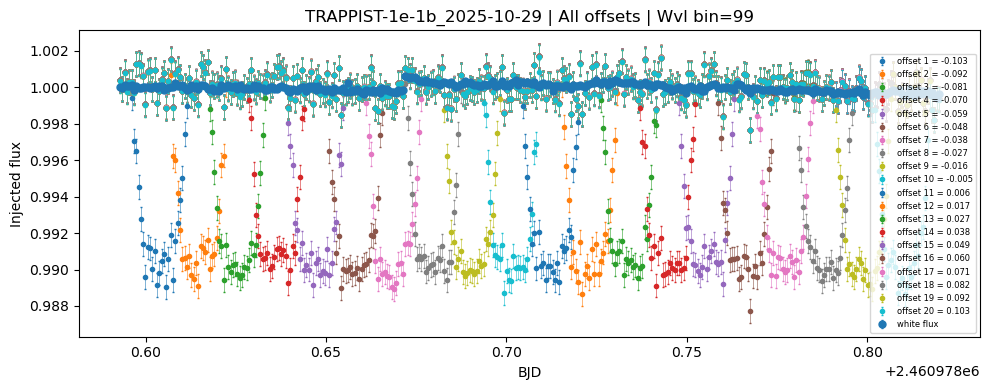

In [15]:
# Inject transit at various times in all bins and plot for selected light curves

for key, d in data_dict_flares_new.items():
    # Mask out the transit for binned data
    it_index = d['it_index'].copy()
    padding = 7
    transit_indices = np.where(it_index == 1)[0]

    for t_idx in transit_indices:
        start = max(0, t_idx - padding)
        end = min(len(it_index), t_idx + padding + 1) 
        it_index[start:t_idx] = 1
        it_index[t_idx + 1:end] = 1

        # Get the out-of-transit bjd times
        bjd_binned_masked = d['bjd_binned'][it_index == 0]
        flux_binned_masked = d['flux_binned'][it_index == 0]
        flux_err_binned_masked = d['flux_err_binned'][it_index == 0]
        white_binned_masked = d['white_binned'][it_index == 0]
        white_err_binned_masked = d['white_err_binned'][it_index == 0]

        if key == "TRAPPIST-1e-1b_2025-10-29":
            # Find transit groups to identify 3rd and 4th transits
            transit_groups = []
            current_group = []
            for i, is_transit in enumerate(it_index):
                if is_transit:
                    current_group.append(i)
                else:
                    if current_group:
                        transit_groups.append(current_group)
                        current_group = []
            if current_group:  # Add last group if it exists
                transit_groups.append(current_group)

            if len(transit_groups) >= 4:
                # Get indices after 3rd transit and before 4th transit
                end_3rd_transit = transit_groups[2][-1]
                start_4th_transit = transit_groups[3][0]
                
                # Create mask for data between 3rd and 4th transits
                between_mask = np.arange(len(d['bjd_binned']))
                between_mask = (between_mask > end_3rd_transit) & (between_mask < start_4th_transit)
                
                # Apply both out-of-transit mask and between-transits mask
                final_mask = (it_index == 0) & between_mask
                
                bjd_binned_masked = d['bjd_binned'][final_mask]
                flux_binned_masked = d['flux_binned'][final_mask]
                flux_err_binned_masked = d['flux_err_binned'][final_mask]
                white_binned_masked = d['white_binned'][final_mask]
                white_err_binned_masked = d['white_err_binned'][final_mask]

    N = 21 # number of offsets
    offset_list= bjd_binned_masked[::int(np.ceil( len(bjd_binned_masked) / N ))] 

    # remove offsets in the edges
    offset_list = offset_list[(offset_list > (bjd_binned_masked.min() + 0.005)) & (offset_list < (bjd_binned_masked.max() - 0.005))]
    
    # remove offsets close to transit
    #bjd_binned_it = d['bjd_binned'][it_index == 1]

    #offset_list = offset_list[(offset_list < (bjd_binned_it.min() - 0.01)) | (offset_list > (bjd_binned_it.max() + 0.01))]
    #print(bjd_binned_it.min(), bjd_binned_it.max())

    offset_list = offset_list - np.mean(bjd_binned_masked)

    #offset_list = [0.02]  # Manually set offsets for testing
    print('Offset list:', offset_list)
    print('Number of offsets:', len(offset_list))

    pl.figure(figsize=(10, 4))
    for jdx, j in enumerate(offset_list):
        
        params = batman.TransitParams()
        params.t0 = np.mean(bjd_binned_masked)+j    #time of inferior conjunction
        params.per = 1.                             #orbital period
        params.a = 15.                              #semi-major axis (in units of stellar radii)
        params.inc = 87.                            #orbital inclination (in degrees)
        params.ecc = 0.                             #eccentricity
        params.w = 90.                              #longitude of periastron (in degrees)
        params.u = [0.1, 0.3]                       #limb darkening coefficients [u1, u2]
        params.limb_dark = "quadratic"              #limb darkening model

        # -----------------------------------------------
        # Inject CHROMATIC transit depths
        # -----------------------------------------------

        # Define chromatic feature
        Rp0 = 0.1            # baseline radius ratio
        A = 0.002            # amplitude of spectral feature  
        lambda0 = 3.5        # center of feature [micron]
        sigma_lambda = 0.3   # width of Gaussian [micron]

        wavelengths = d['wavelength']  # array of wavelength bins

        # Compute chromatic Rp(λ)
        Rp_lambda = Rp0 + A * np.exp(-0.5 * ((wavelengths - lambda0) / sigma_lambda)**2)

        # Inject chromatic transit model
        flux_binned_masked_injected = np.zeros_like(flux_binned_masked)

        for i in range(flux_binned_masked.shape[1]):
            # update transit parameters for this wavelength
            params.rp = Rp_lambda[i]

            m = batman.TransitModel(params, bjd_binned_masked)
            chromatic_flux = m.light_curve(params)

            baseline_mask = (chromatic_flux == 1.0)

            # injection: remove original baseline, add chromatic transit model
            flux_binned_masked_injected[:, i] = (flux_binned_masked[:, i] - np.median(flux_binned_masked[baseline_mask, i]) + chromatic_flux)


        # Plot one wavelength bin for each offset
        for i in np.linspace(100, flux_binned_masked.shape[1] - 100, 1):
            pl.errorbar(bjd_binned_masked, flux_binned_masked_injected[:, int(i) - 1], 
                        flux_err_binned_masked[:, int(i) - 1],
                        fmt='o', capsize=0.4, markersize=3, elinewidth=0.4, 
                        label=f'offset {jdx+1} = {j:.3f}')

    # Plot white flux once
    pl.errorbar(bjd_binned_masked, white_binned_masked, white_err_binned_masked, 
                fmt='o', capsize=0.5, markersize=5, elinewidth=0.5, label='white flux')
    pl.title(f"{key} | All offsets | Wvl bin={int(i) - 1}")
    pl.xlabel('BJD')
    pl.ylabel('Injected flux')
    pl.legend(fontsize=6, loc='lower right')
    pl.tight_layout()
    pl.show()

## Plot components of the model

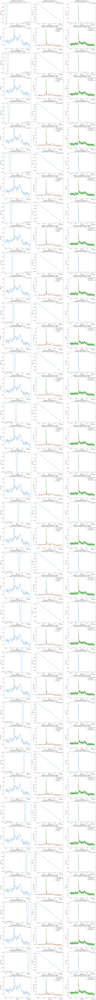

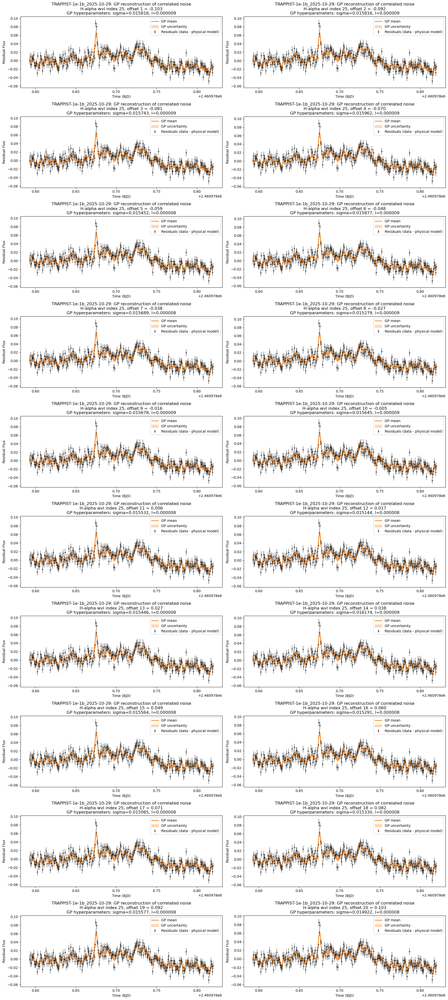

In [16]:
# Plot components of the model for halpha bin

n_lc = len(data_dict_flares_new)
n_offsets = len(offset_list)
fig, axes = pl.subplots(2*n_lc * n_offsets, 3, figsize=(24, 13 * n_lc * n_offsets))

# Also plot the residuals in a separate figure with fixed number of columns
n_cols = 2
n_rows = int(np.ceil(n_offsets / n_cols)) * n_lc

fig_res, axes_res = pl.subplots(n_rows, n_cols, figsize=(9 * n_cols, 4 * n_rows), squeeze=False)

if n_lc * n_offsets == 1:
    axes = axes.reshape(2, 3)

plot_idx = 0
for idx, (key, d) in enumerate(data_dict_flares_new.items()):

    halpha_wavelength = 0.6563 # microns
    halpha_bin = np.argmin(np.abs(d['wavelength'] - halpha_wavelength))
    
    # Mask out the transit for binned data
    it_index = d['it_index'].copy()
    padding = 7
    transit_indices = np.where(it_index == 1)[0]

    for t_idx in transit_indices:
        start = max(0, t_idx - padding)
        end = min(len(it_index), t_idx + padding + 1)
        it_index[start:t_idx] = 1
        it_index[t_idx + 1:end] = 1

    bjd_binned_masked = d['bjd_binned'][it_index == 0]
    flux_binned_masked = d['flux_binned'][it_index == 0]
    white_binned_masked = d['white_binned'][it_index == 0]
    white_err_binned_masked = d['white_err_binned'][it_index == 0]
    flux_err_binned_masked = d['flux_err_binned'][it_index == 0]

    if key == "TRAPPIST-1e-1b_2025-10-29":
        # Find transit groups to identify 3rd and 4th transits
        transit_groups = []
        current_group = []
        for i, is_transit in enumerate(it_index):
            if is_transit:
                current_group.append(i)
            else:
                if current_group:
                    transit_groups.append(current_group)
                    current_group = []
        if current_group:  # Add last group if it exists
            transit_groups.append(current_group)

        if len(transit_groups) >= 4:
            # Get indices after 3rd transit and before 4th transit
            end_3rd_transit = transit_groups[2][-1]
            start_4th_transit = transit_groups[3][0]
            
            # Create mask for data between 3rd and 4th transits
            between_mask = np.arange(len(d['bjd_binned']))
            between_mask = (between_mask > end_3rd_transit) & (between_mask < start_4th_transit)
            
            # Apply both out-of-transit mask and between-transits mask
            final_mask = (it_index == 0) & between_mask
            
            bjd_binned_masked = d['bjd_binned'][final_mask]
            flux_binned_masked = d['flux_binned'][final_mask]
            flux_err_binned_masked = d['flux_err_binned'][final_mask]
            white_binned_masked = d['white_binned'][final_mask]
            white_err_binned_masked = d['white_err_binned'][final_mask]


    for jdx,j in enumerate(offset_list):
        
        output_filename = f'outputs/mcmc_results_{key}_{j:.5f}_gp_feature.txt'

        # Load existing results
        data = np.loadtxt(output_filename, delimiter=',', skiprows=1)
        rp_fits = data[:, 0]
        rp_errs = data[:, 1]
        slope_fits = data[:, 2]
        slope_errs = data[:, 3]
        intercept_fits = data[:, 4]
        intercept_errs = data[:, 5]
        tpeak_fits = data[:, 6]
        tpeak_errs = data[:, 7]
        fwhm_fits = data[:, 8]
        fwhm_errs = data[:, 9]
        ampl_fits = data[:, 10]
        ampl_errs = data[:, 11]
        sigma_fits = data[:, 12]
        sigma_errs = data[:, 13]
        l_fits = data[:, 14]
        l_errs = data[:, 15]

        ax1, ax2, ax3 = axes[plot_idx]

        params = batman.TransitParams()
        params.t0 = np.mean(bjd_binned_masked)+j    #time of inferior conjunction
        params.per = 1.                             #orbital period
        params.a = 15.                              #semi-major axis (in units of stellar radii)
        params.inc = 87.                            #orbital inclination (in degrees)
        params.ecc = 0.                             #eccentricity
        params.w = 90.                              #longitude of periastron (in degrees)
        params.u = [0.1, 0.3]                       #limb darkening coefficients [u1, u2]
        params.limb_dark = "quadratic"              #limb darkening model

        # -----------------------------------------------
        # Inject CHROMATIC transit depths
        # -----------------------------------------------

        # Define chromatic feature
        Rp0 = 0.1            # baseline radius ratio
        A = 0.002            # amplitude of spectral feature  
        lambda0 = 3.5        # center of feature [micron]
        sigma_lambda = 0.3   # width of Gaussian [micron]

        wavelengths = d['wavelength']  # array of wavelength bins

        # Compute chromatic Rp(λ)
        Rp_lambda = Rp0 + A * np.exp(-0.5 * ((wavelengths - lambda0) / sigma_lambda)**2)

        # Inject chromatic transit model
        flux_binned_masked_injected = np.zeros_like(flux_binned_masked)
        
        batman_models = []
        for i in range(flux_binned_masked.shape[1]):
            # update transit parameters for this wavelength
            params.rp = Rp_lambda[i]

            m = batman.TransitModel(params, bjd_binned_masked)
            chromatic_flux = m.light_curve(params)

            batman_models.append(chromatic_flux)

            baseline_mask = (chromatic_flux == 1.0)

            # injection: remove original baseline, add chromatic transit model
            flux_binned_masked_injected[:, i] = (flux_binned_masked[:, i] - np.median(flux_binned_masked[baseline_mask, i]) + chromatic_flux)

        # Add best-fit model for h-alpha bin
        best_fit_model_halpha = (batman_models[halpha_bin] +
                          slope_fits[halpha_bin] * (bjd_binned_masked - bjd_binned_masked[0]) + intercept_fits[halpha_bin] +
                          flare_model(bjd_binned_masked, tpeak_fits[halpha_bin], fwhm_fits[halpha_bin], ampl_fits[halpha_bin]))
        
        # Compute model components for H-alpha bin
        batman_model = batman_models[halpha_bin]
        linear_model = slope_fits[halpha_bin] * (bjd_binned_masked - bjd_binned_masked[0]) + intercept_fits[halpha_bin]
        flare = flare_model(bjd_binned_masked, tpeak_fits[halpha_bin], fwhm_fits[halpha_bin], ampl_fits[halpha_bin])

        gp_halpha = build_gp(sigma_fits[halpha_bin], l_fits[halpha_bin], bjd_binned_masked , flux_err_binned_masked[:, halpha_bin])

        residuals_halpha = flux_binned_masked_injected[:, halpha_bin] - best_fit_model_halpha
        gp_mean_halpha, gp_cov_halpha = gp_halpha.predict(residuals_halpha, bjd_binned_masked, return_cov=True)

        # Plot each component separately
        ax1.plot(bjd_binned_masked, batman_model, '-', label='Transit (batman)')
        ax1.set_xlabel('Time [BJD]')
        ax1.set_ylabel('Relative flux')
        ax1.set_title(f'{key}: \nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}')
        ax1.legend()

        ax2.plot(bjd_binned_masked, linear_model, '-', label='Linear systematics')
        ax2.set_xlabel('Time [BJD]')
        ax2.set_ylabel('Relative flux')
        ax2.set_title(f'{key}: \nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}')
        ax2.legend()

        ax3.plot(bjd_binned_masked, flare, '-', label='Flare model')
        ax3.set_xlabel('Time [BJD]')
        ax3.set_ylabel('Relative flux')
        ax3.set_title(f'{key}: \nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}')
        ax3.legend()

        # Change row of subplots
        plot_idx += 1

        ax4, ax5, ax6 = axes[plot_idx]

        ax4.plot(bjd_binned_masked, gp_mean_halpha, '-', label='GP model')
        ax4.set_xlabel('Time [BJD]')
        ax4.set_ylabel('Relative flux')
        ax4.set_title(f'{key}: \nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}')
        ax4.legend()

        # Plot all models together
        
        # ACTUALLY don't normalize, just plot as is because we want to see relative contributions
        #def normalize(y):
        #    return (y - np.min(y)) / (np.max(y) - np.min(y))

        ax5.plot(bjd_binned_masked, batman_model-1, label='Transit (batman)')
        ax5.plot(bjd_binned_masked, linear_model, label='Linear systematics')
        ax5.plot(bjd_binned_masked, flare, label='Flare model')
        ax5.plot(bjd_binned_masked, gp_mean_halpha, label='GP model')
        ax5.set_xlabel('Time [BJD]')
        ax5.set_ylabel('Model contribution')
        ax5.set_title(f'{key}: All models\nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}')
        ax5.legend()

        # Plot best fit model
        ax6.plot(bjd_binned_masked, best_fit_model_halpha + gp_mean_halpha, label='best fit model + GP')
        ax6.plot(bjd_binned_masked, best_fit_model_halpha, label='best fit model')

        # Plot data on top
        ax6.errorbar(bjd_binned_masked, flux_binned_masked_injected[:, halpha_bin], yerr=flux_err_binned_masked[:, halpha_bin], 
                     fmt='o', capsize=0.4, markersize=4, elinewidth=0.4, label=f'injected transit flux')
        #ax6.errorbar(bjd_binned_masked, flux_binned_masked[:, halpha_bin], yerr=flux_err_binned_masked[:, halpha_bin], 
        #             fmt='o', capsize=0.4, markersize=4, elinewidth=0.4, label=f'original flux')
        ax6.set_xlabel('Time [BJD]')
        ax6.set_ylabel('Relative flux')
        ax6.set_title(f'{key}: Data & best fit\nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}')
        ax6.legend()

        plot_idx += 1

        # Plot GP reconstruction of correlated noise
        row = idx * n_rows // n_lc + jdx // n_cols
        col = jdx % n_cols

        ax_res = axes_res[row, col]

        std_halpha = np.sqrt(np.diag(gp_cov_halpha))

        ax_res.errorbar(bjd_binned_masked, residuals_halpha, yerr=flux_err_binned_masked[:, halpha_bin], 
                    fmt=".k", alpha=0.5, label="Residuals (data - physical model)")
        ax_res.plot(bjd_binned_masked, gp_mean_halpha, color="C1", lw=2, label="GP mean")
        ax_res.fill_between(bjd_binned_masked, gp_mean_halpha - std_halpha, gp_mean_halpha + std_halpha, color="C1", alpha=0.3, label="GP uncertainty")
        ax_res.set_xlabel("Time (BJD)")
        ax_res.set_ylabel("Residual Flux")
        ax_res.legend()
        ax_res.set_title(f'{key}: GP reconstruction of correlated noise\nH-alpha wvl index {halpha_bin}, offset {jdx+1} = {j:.3f}\nGP hyperparameters: sigma={sigma_fits[halpha_bin]:.6f}, l={l_fits[halpha_bin]:.6f}')
    
pl.tight_layout()
pl.show()

minimum of batman model: 0.9900207557852911
Offset 1 = -0.103: GP hyperparameters across all wavelength bins:
Max sigma: 0.498467, Min sigma: 0.000145, Average sigma: 0.006451
Max l: 0.007289, Min l: 0.000001, Average l: 0.005408
---
minimum of batman model: 0.9900207557852911
Offset 2 = -0.092: GP hyperparameters across all wavelength bins:
Max sigma: 0.498388, Min sigma: 0.000136, Average sigma: 0.006370
Max l: 0.007299, Min l: 0.000001, Average l: 0.005372
---
minimum of batman model: 0.9900207557852911
Offset 3 = -0.081: GP hyperparameters across all wavelength bins:
Max sigma: 0.498569, Min sigma: 0.000103, Average sigma: 0.006405
Max l: 0.007329, Min l: 0.000001, Average l: 0.005363
---
minimum of batman model: 0.9900207557852911
Offset 4 = -0.070: GP hyperparameters across all wavelength bins:
Max sigma: 0.498835, Min sigma: 0.000123, Average sigma: 0.006367
Max l: 0.007490, Min l: 0.000001, Average l: 0.005363
---
minimum of batman model: 0.9900207557852911
Offset 5 = -0.059: G

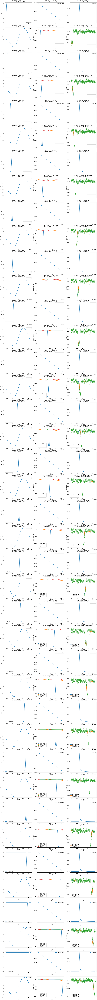

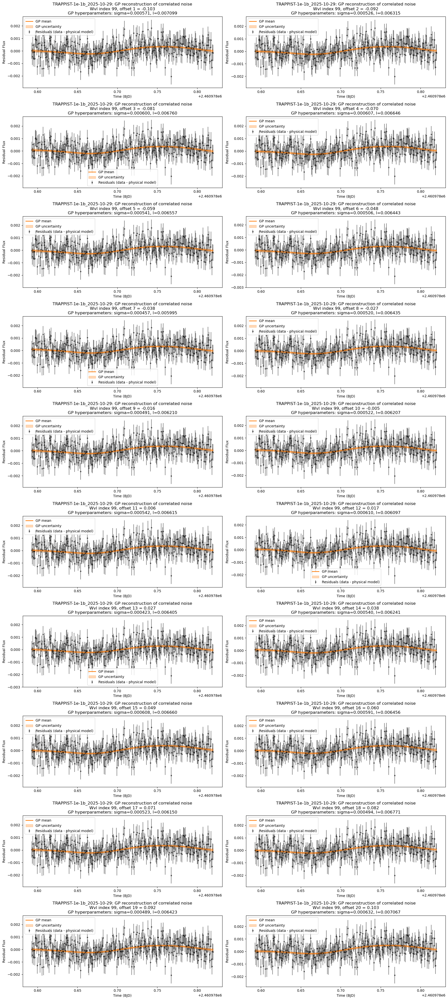

In [17]:
# Plot components of the model for wvl bin

wvl_bin = 99 # Wavelength bin to plot

n_lc = len(data_dict_flares_new)
n_offsets = len(offset_list)
fig, axes = pl.subplots(2*n_lc * n_offsets, 3, figsize=(24, 13 * n_lc * n_offsets))

# Also plot the residuals in a separate figure with fixed number of columns
n_cols = 2
n_rows = int(np.ceil(n_offsets / n_cols)) * n_lc

fig_res, axes_res = pl.subplots(n_rows, n_cols, figsize=(9 * n_cols, 4 * n_rows), squeeze=False)

if n_lc * n_offsets == 1:
    axes = axes.reshape(2, 3)

plot_idx = 0
for idx, (key, d) in enumerate(data_dict_flares_new.items()):
    # Mask out the transit for binned data
    it_index = d['it_index'].copy()
    padding = 7
    transit_indices = np.where(it_index == 1)[0]

    for t_idx in transit_indices:
        start = max(0, t_idx - padding)
        end = min(len(it_index), t_idx + padding + 1)
        it_index[start:t_idx] = 1
        it_index[t_idx + 1:end] = 1

    bjd_binned_masked = d['bjd_binned'][it_index == 0]
    flux_binned_masked = d['flux_binned'][it_index == 0]
    white_binned_masked = d['white_binned'][it_index == 0]
    white_err_binned_masked = d['white_err_binned'][it_index == 0]
    flux_err_binned_masked = d['flux_err_binned'][it_index == 0]

    if key == "TRAPPIST-1e-1b_2025-10-29":
        # Find transit groups to identify 3rd and 4th transits
        transit_groups = []
        current_group = []
        for i, is_transit in enumerate(it_index):
            if is_transit:
                current_group.append(i)
            else:
                if current_group:
                    transit_groups.append(current_group)
                    current_group = []
        if current_group:  # Add last group if it exists
            transit_groups.append(current_group)

        if len(transit_groups) >= 4:
            # Get indices after 3rd transit and before 4th transit
            end_3rd_transit = transit_groups[2][-1]
            start_4th_transit = transit_groups[3][0]
            
            # Create mask for data between 3rd and 4th transits
            between_mask = np.arange(len(d['bjd_binned']))
            between_mask = (between_mask > end_3rd_transit) & (between_mask < start_4th_transit)
            
            # Apply both out-of-transit mask and between-transits mask
            final_mask = (it_index == 0) & between_mask
            
            bjd_binned_masked = d['bjd_binned'][final_mask]
            flux_binned_masked = d['flux_binned'][final_mask]
            flux_err_binned_masked = d['flux_err_binned'][final_mask]
            white_binned_masked = d['white_binned'][final_mask]
            white_err_binned_masked = d['white_err_binned'][final_mask]

    for jdx,j in enumerate(offset_list):
        
        output_filename = f'outputs/mcmc_results_{key}_{j:.5f}_gp_feature.txt'

        # Load existing results
        data = np.loadtxt(output_filename, delimiter=',', skiprows=1)
        rp_fits = data[:, 0]
        rp_errs = data[:, 1]
        slope_fits = data[:, 2]
        slope_errs = data[:, 3]
        intercept_fits = data[:, 4]
        intercept_errs = data[:, 5]
        tpeak_fits = data[:, 6]
        tpeak_errs = data[:, 7]
        fwhm_fits = data[:, 8]
        fwhm_errs = data[:, 9]
        ampl_fits = data[:, 10]
        ampl_errs = data[:, 11]
        sigma_fits = data[:, 12]
        sigma_errs = data[:, 13]
        l_fits = data[:, 14]
        l_errs = data[:, 15]

        ax1, ax2, ax3 = axes[plot_idx]
        
        params = batman.TransitParams()
        params.t0 = np.mean(bjd_binned_masked)+j    #time of inferior conjunction
        params.per = 1.                             #orbital period
        params.a = 15.                              #semi-major axis (in units of stellar radii)
        params.inc = 87.                            #orbital inclination (in degrees)
        params.ecc = 0.                             #eccentricity
        params.w = 90.                              #longitude of periastron (in degrees)
        params.u = [0.1, 0.3]                       #limb darkening coefficients [u1, u2]
        params.limb_dark = "quadratic"              #limb darkening model

        # -----------------------------------------------
        # Inject CHROMATIC transit depths
        # -----------------------------------------------

        # Define chromatic feature
        Rp0 = 0.1            # baseline radius ratio
        A = 0.002            # amplitude of spectral feature  
        lambda0 = 3.5        # center of feature [micron]
        sigma_lambda = 0.3   # width of Gaussian [micron]

        wavelengths = d['wavelength']  # array of wavelength bins

        # Compute chromatic Rp(λ)
        Rp_lambda = Rp0 + A * np.exp(-0.5 * ((wavelengths - lambda0) / sigma_lambda)**2)

        # Inject chromatic transit model
        flux_binned_masked_injected = np.zeros_like(flux_binned_masked)

        batman_models = []

        for i in range(flux_binned_masked.shape[1]):
            # update transit parameters for this wavelength
            params.rp = Rp_lambda[i]

            m = batman.TransitModel(params, bjd_binned_masked)
            chromatic_flux = m.light_curve(params)

            batman_models.append(chromatic_flux)

            baseline_mask = (chromatic_flux == 1.0)

            # injection: remove original baseline, add chromatic transit model
            flux_binned_masked_injected[:, i] = (flux_binned_masked[:, i] - np.median(flux_binned_masked[baseline_mask, i]) + chromatic_flux)
        
        # Add best-fit model for h-alpha bin
        best_fit_model_wvl = (batman_models[wvl_bin] +
                          slope_fits[wvl_bin] * (bjd_binned_masked - bjd_binned_masked[0]) + intercept_fits[wvl_bin] +
                          flare_model(bjd_binned_masked, tpeak_fits[wvl_bin], fwhm_fits[wvl_bin], ampl_fits[wvl_bin]))

        # Compute model components for H-alpha bin
        batman_model = batman_models[wvl_bin]
        print('minimum of batman model:', np.min(batman_model))
        linear_model = slope_fits[wvl_bin] * (bjd_binned_masked - bjd_binned_masked[0]) + intercept_fits[wvl_bin]
        flare = flare_model(bjd_binned_masked, tpeak_fits[wvl_bin], fwhm_fits[wvl_bin], ampl_fits[wvl_bin])

        gp_wvl = build_gp(sigma_fits[wvl_bin], l_fits[wvl_bin], bjd_binned_masked , flux_err_binned_masked[:, wvl_bin])

        residuals_wvl = flux_binned_masked_injected[:, wvl_bin] - best_fit_model_wvl
        gp_mean_wvl, gp_cov_wvl = gp_wvl.predict(residuals_wvl, bjd_binned_masked, return_cov=True)

        # Plot each component separately
        ax1.plot(bjd_binned_masked, batman_model, '-', label='Transit (batman)')
        ax1.set_xlabel('Time [BJD]')
        ax1.set_ylabel('Relative flux')
        ax1.set_title(f'{key}: \nWvl index {wvl_bin}, offset {jdx+1} = {j:.3f}')
        ax1.legend()

        ax2.plot(bjd_binned_masked, linear_model, '-', label='Linear systematics')
        ax2.set_xlabel('Time [BJD]')
        ax2.set_ylabel('Relative flux')
        ax2.set_title(f'{key}: \nWvl index {wvl_bin}, offset {jdx+1} = {j:.3f}')
        ax2.legend()

        ax3.plot(bjd_binned_masked, flare, '-', label='Flare model')
        ax3.set_xlabel('Time [BJD]')
        ax3.set_ylabel('Relative flux')
        ax3.set_title(f'{key}: \nWvl index {wvl_bin}, offset {jdx+1} = {j:.3f}')
        ax3.legend()

        # Change row of subplots
        plot_idx += 1

        ax4, ax5, ax6 = axes[plot_idx]

        ax4.plot(bjd_binned_masked, gp_mean_wvl, '-', label='GP model')
        ax4.set_xlabel('Time [BJD]')
        ax4.set_ylabel('Relative flux')
        ax4.set_title(f'{key}: \nWvl index {wvl_bin}, offset {jdx+1} = {j:.3f}')
        ax4.legend()

        # Plot all models together
        
        # ACTUALLY don't normalize, just plot as is because we want to see relative contributions
        #def normalize(y): 
        #    return (y - np.min(y)) / (np.max(y) - np.min(y))

        ax5.plot(bjd_binned_masked, batman_model-1, label='Transit (batman)')
        ax5.plot(bjd_binned_masked, linear_model, label='Linear systematics')
        ax5.plot(bjd_binned_masked, flare, label='Flare model')
        ax5.plot(bjd_binned_masked, gp_mean_wvl, label='GP model')
        ax5.set_xlabel('Time [BJD]')
        ax5.set_ylabel('Model contribution')
        ax5.set_title(f'{key}: All models\nwvl index {wvl_bin}, offset {jdx+1} = {j:.3f}')
        ax5.legend()

        # Plot best fit model
        ax6.plot(bjd_binned_masked, best_fit_model_wvl + gp_mean_wvl, label='best fit model + GP')
        ax6.plot(bjd_binned_masked, best_fit_model_wvl, label='best fit model')

        # Plot data on top
        ax6.errorbar(bjd_binned_masked, flux_binned_masked_injected[:, wvl_bin], yerr=flux_err_binned_masked[:, wvl_bin], 
                     fmt='o', capsize=0.4, markersize=4, elinewidth=0.4, label=f'injected transit flux')
        #ax6.errorbar(bjd_binned_masked, flux_binned_masked[:, wvl_bin], yerr=flux_err_binned_masked[:, wvl_bin], 
        #             fmt='o', capsize=0.4, markersize=4, elinewidth=0.4, label=f'original flux')
        ax6.set_xlabel('Time [BJD]')
        ax6.set_ylabel('Relative flux')
        ax6.set_title(f'{key}: Data & best fit\nWvl index {wvl_bin}, offset {jdx+1} = {j:.3f}')
        ax6.legend()

        plot_idx += 1

        # Plot GP reconstruction of correlated noise 
        row = idx * n_rows // n_lc + jdx // n_cols
        col = jdx % n_cols

        ax_res = axes_res[row, col]

        std_wvl = np.sqrt(np.diag(gp_cov_wvl))

        ax_res.errorbar(bjd_binned_masked, residuals_wvl, yerr=flux_err_binned_masked[:, wvl_bin], 
                    fmt=".k", alpha=0.5, label="Residuals (data - physical model)")
        ax_res.plot(bjd_binned_masked, gp_mean_wvl, color="C1", lw=2, label="GP mean")
        ax_res.fill_between(bjd_binned_masked, gp_mean_wvl - std_wvl, gp_mean_wvl + std_wvl, color="C1", alpha=0.3, label="GP uncertainty")
        ax_res.set_xlabel("Time (BJD)")
        ax_res.set_ylabel("Residual Flux")
        ax_res.legend()
        ax_res.set_title(f'{key}: GP reconstruction of correlated noise\nWvl index {wvl_bin}, offset {jdx+1} = {j:.3f}\nGP hyperparameters: sigma={sigma_fits[wvl_bin]:.6f}, l={l_fits[wvl_bin]:.6f}')
   
        # print max and min of each gp hyperparameter across all bins
        print(f'Offset {jdx+1} = {j:.3f}: GP hyperparameters across all wavelength bins:')
        print(f'Max sigma: {np.max(sigma_fits):.6f}, Min sigma: {np.min(sigma_fits):.6f}, Average sigma: {np.mean(sigma_fits):.6f}')
        print(f'Max l: {np.max(l_fits):.6f}, Min l: {np.min(l_fits):.6f}, Average l: {np.mean(l_fits):.6f}')
        print('---') 
        
pl.tight_layout()
pl.show()

minimum of batman model: 0.9896194310668699
Offset 1 = -0.103: GP hyperparameters across all wavelength bins:
Max sigma: 0.498467, Min sigma: 0.000145, Average sigma: 0.006451
Max l: 0.007289, Min l: 0.000001, Average l: 0.005408
---
minimum of batman model: 0.9896194310668699
Offset 2 = -0.092: GP hyperparameters across all wavelength bins:
Max sigma: 0.498388, Min sigma: 0.000136, Average sigma: 0.006370
Max l: 0.007299, Min l: 0.000001, Average l: 0.005372
---
minimum of batman model: 0.9896194310668699
Offset 3 = -0.081: GP hyperparameters across all wavelength bins:
Max sigma: 0.498569, Min sigma: 0.000103, Average sigma: 0.006405
Max l: 0.007329, Min l: 0.000001, Average l: 0.005363
---
minimum of batman model: 0.9896194310668699
Offset 4 = -0.070: GP hyperparameters across all wavelength bins:
Max sigma: 0.498835, Min sigma: 0.000123, Average sigma: 0.006367
Max l: 0.007490, Min l: 0.000001, Average l: 0.005363
---
minimum of batman model: 0.9896194310668699
Offset 5 = -0.059: G

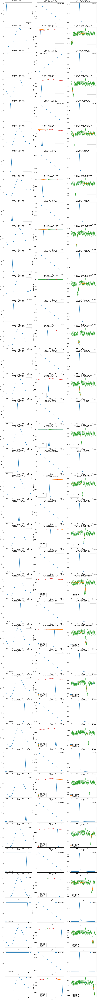

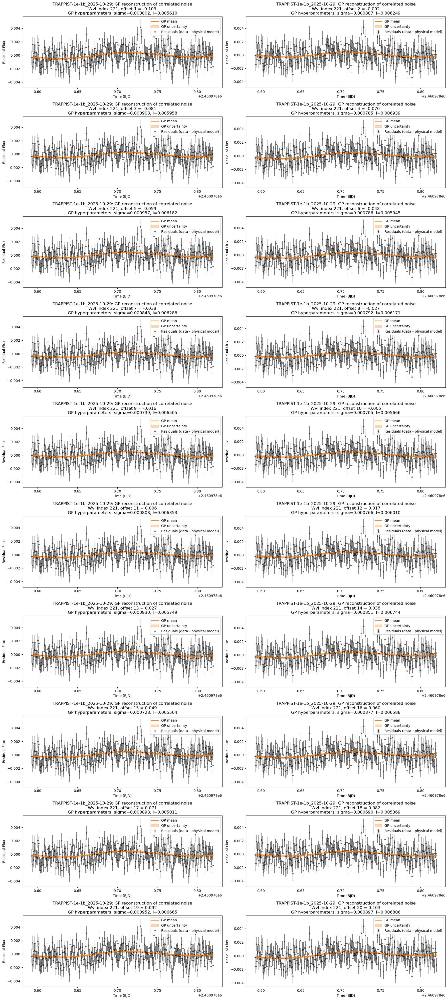

In [18]:
# Plot components of the model for 3.5 micron bin (feature bin)

n_lc = len(data_dict_flares_new)
n_offsets = len(offset_list)
fig, axes = pl.subplots(2*n_lc * n_offsets, 3, figsize=(24, 13 * n_lc * n_offsets))

# Also plot the residuals in a separate figure with fixed number of columns
n_cols = 2
n_rows = int(np.ceil(n_offsets / n_cols)) * n_lc

fig_res, axes_res = pl.subplots(n_rows, n_cols, figsize=(9 * n_cols, 4 * n_rows), squeeze=False)

if n_lc * n_offsets == 1:
    axes = axes.reshape(2, 3)

plot_idx = 0
for idx, (key, d) in enumerate(data_dict_flares_new.items()):

    feature_wavelength = 3.5 # microns
    feature_bin = np.argmin(np.abs(d['wavelength'] - feature_wavelength))

    # Mask out the transit for binned data
    it_index = d['it_index'].copy()
    padding = 7
    transit_indices = np.where(it_index == 1)[0]

    for t_idx in transit_indices:
        start = max(0, t_idx - padding)
        end = min(len(it_index), t_idx + padding + 1)
        it_index[start:t_idx] = 1
        it_index[t_idx + 1:end] = 1

    bjd_binned_masked = d['bjd_binned'][it_index == 0]
    flux_binned_masked = d['flux_binned'][it_index == 0]
    white_binned_masked = d['white_binned'][it_index == 0]
    white_err_binned_masked = d['white_err_binned'][it_index == 0]
    flux_err_binned_masked = d['flux_err_binned'][it_index == 0]

    if key == "TRAPPIST-1e-1b_2025-10-29":
        # Find transit groups to identify 3rd and 4th transits
        transit_groups = []
        current_group = []
        for i, is_transit in enumerate(it_index):
            if is_transit:
                current_group.append(i)
            else:
                if current_group:
                    transit_groups.append(current_group)
                    current_group = []
        if current_group:  # Add last group if it exists
            transit_groups.append(current_group)

        if len(transit_groups) >= 4:
            # Get indices after 3rd transit and before 4th transit
            end_3rd_transit = transit_groups[2][-1]
            start_4th_transit = transit_groups[3][0]
            
            # Create mask for data between 3rd and 4th transits
            between_mask = np.arange(len(d['bjd_binned']))
            between_mask = (between_mask > end_3rd_transit) & (between_mask < start_4th_transit)
            
            # Apply both out-of-transit mask and between-transits mask
            final_mask = (it_index == 0) & between_mask
            
            bjd_binned_masked = d['bjd_binned'][final_mask]
            flux_binned_masked = d['flux_binned'][final_mask]
            flux_err_binned_masked = d['flux_err_binned'][final_mask]
            white_binned_masked = d['white_binned'][final_mask]
            white_err_binned_masked = d['white_err_binned'][final_mask]

    for jdx,j in enumerate(offset_list):
        
        output_filename = f'outputs/mcmc_results_{key}_{j:.5f}_gp_feature.txt'

        # Load existing results
        data = np.loadtxt(output_filename, delimiter=',', skiprows=1)
        rp_fits = data[:, 0]
        rp_errs = data[:, 1]
        slope_fits = data[:, 2]
        slope_errs = data[:, 3]
        intercept_fits = data[:, 4]
        intercept_errs = data[:, 5]
        tpeak_fits = data[:, 6]
        tpeak_errs = data[:, 7]
        fwhm_fits = data[:, 8]
        fwhm_errs = data[:, 9]
        ampl_fits = data[:, 10]
        ampl_errs = data[:, 11]
        sigma_fits = data[:, 12]
        sigma_errs = data[:, 13]
        l_fits = data[:, 14]
        l_errs = data[:, 15]

        ax1, ax2, ax3 = axes[plot_idx]
        
        params = batman.TransitParams()
        params.t0 = np.mean(bjd_binned_masked)+j    #time of inferior conjunction
        params.per = 1.                             #orbital period
        params.a = 15.                              #semi-major axis (in units of stellar radii)
        params.inc = 87.                            #orbital inclination (in degrees)
        params.ecc = 0.                             #eccentricity
        params.w = 90.                              #longitude of periastron (in degrees)
        params.u = [0.1, 0.3]                       #limb darkening coefficients [u1, u2]
        params.limb_dark = "quadratic"              #limb darkening model

        # -----------------------------------------------
        # Inject CHROMATIC transit depths
        # -----------------------------------------------

        # Define chromatic feature
        Rp0 = 0.1            # baseline radius ratio
        A = 0.002            # amplitude of spectral feature  
        lambda0 = 3.5        # center of feature [micron]
        sigma_lambda = 0.3   # width of Gaussian [micron]

        wavelengths = d['wavelength']  # array of wavelength bins

        # Compute chromatic Rp(λ)
        Rp_lambda = Rp0 + A * np.exp(-0.5 * ((wavelengths - lambda0) / sigma_lambda)**2)

        # Inject chromatic transit model
        flux_binned_masked_injected = np.zeros_like(flux_binned_masked)

        batman_models = []
        for i in range(flux_binned_masked.shape[1]):
            # update transit parameters for this wavelength
            params.rp = Rp_lambda[i]

            m = batman.TransitModel(params, bjd_binned_masked)
            chromatic_flux = m.light_curve(params)

            batman_models.append(chromatic_flux)

            baseline_mask = (chromatic_flux == 1.0)

            # injection: remove original baseline, add chromatic transit model
            flux_binned_masked_injected[:, i] = (flux_binned_masked[:, i] - np.median(flux_binned_masked[baseline_mask, i]) + chromatic_flux)
        
        # Add best-fit model for feature bin
        best_fit_model_wvl = (batman_models[feature_bin] +
                          slope_fits[feature_bin] * (bjd_binned_masked - bjd_binned_masked[0]) + intercept_fits[feature_bin] +
                          flare_model(bjd_binned_masked, tpeak_fits[feature_bin], fwhm_fits[feature_bin], ampl_fits[feature_bin]))

        # Compute model components for feature bin
        batman_model = batman_models[feature_bin]
        print('minimum of batman model:', np.min(batman_model))
        linear_model = slope_fits[feature_bin] * (bjd_binned_masked - bjd_binned_masked[0]) + intercept_fits[feature_bin]
        flare = flare_model(bjd_binned_masked, tpeak_fits[feature_bin], fwhm_fits[feature_bin], ampl_fits[feature_bin])

        gp_wvl = build_gp(sigma_fits[feature_bin], l_fits[feature_bin], bjd_binned_masked , flux_err_binned_masked[:, feature_bin])

        residuals_wvl = flux_binned_masked_injected[:, feature_bin] - best_fit_model_wvl
        gp_mean_wvl, gp_cov_wvl = gp_wvl.predict(residuals_wvl, bjd_binned_masked, return_cov=True)

        # Plot each component separately
        ax1.plot(bjd_binned_masked, batman_model, '-', label='Transit (batman)')
        ax1.set_xlabel('Time [BJD]')
        ax1.set_ylabel('Relative flux')
        ax1.set_title(f'{key}: \nWvl index {feature_bin}, offset {jdx+1} = {j:.3f}')
        ax1.legend()

        ax2.plot(bjd_binned_masked, linear_model, '-', label='Linear systematics')
        ax2.set_xlabel('Time [BJD]')
        ax2.set_ylabel('Relative flux')
        ax2.set_title(f'{key}: \nWvl index {feature_bin}, offset {jdx+1} = {j:.3f}')
        ax2.legend()

        ax3.plot(bjd_binned_masked, flare, '-', label='Flare model')
        ax3.set_xlabel('Time [BJD]')
        ax3.set_ylabel('Relative flux')
        ax3.set_title(f'{key}: \nWvl index {feature_bin}, offset {jdx+1} = {j:.3f}')
        ax3.legend()

        # Change row of subplots
        plot_idx += 1

        ax4, ax5, ax6 = axes[plot_idx]

        ax4.plot(bjd_binned_masked, gp_mean_wvl, '-', label='GP model')
        ax4.set_xlabel('Time [BJD]')
        ax4.set_ylabel('Relative flux')
        ax4.set_title(f'{key}: \nWvl index {feature_bin}, offset {jdx+1} = {j:.3f}')
        ax4.legend()

        # Plot all models together
        
        # ACTUALLY don't normalize, just plot as is because we want to see relative contributions
        #def normalize(y): 
        #    return (y - np.min(y)) / (np.max(y) - np.min(y))

        ax5.plot(bjd_binned_masked, batman_model-1, label='Transit (batman)')
        ax5.plot(bjd_binned_masked, linear_model, label='Linear systematics')
        ax5.plot(bjd_binned_masked, flare, label='Flare model')
        ax5.plot(bjd_binned_masked, gp_mean_wvl, label='GP model')
        ax5.set_xlabel('Time [BJD]')
        ax5.set_ylabel('Model contribution')
        ax5.set_title(f'{key}: All models\nwvl index {feature_bin}, offset {jdx+1} = {j:.3f}')
        ax5.legend()

        # Plot best fit model
        ax6.plot(bjd_binned_masked, best_fit_model_wvl + gp_mean_wvl, label='best fit model + GP')
        ax6.plot(bjd_binned_masked, best_fit_model_wvl, label='best fit model')

        # Plot data on top
        ax6.errorbar(bjd_binned_masked, flux_binned_masked_injected[:, feature_bin], yerr=flux_err_binned_masked[:, feature_bin], 
                     fmt='o', capsize=0.4, markersize=4, elinewidth=0.4, label=f'injected transit flux')
        #ax6.errorbar(bjd_binned_masked, flux_binned_masked[:, feature_bin], yerr=flux_err_binned_masked[:, feature_bin], 
        #             fmt='o', capsize=0.4, markersize=4, elinewidth=0.4, label=f'original flux')
        ax6.set_xlabel('Time [BJD]')
        ax6.set_ylabel('Relative flux')
        ax6.set_title(f'{key}: Data & best fit\nWvl index {feature_bin}, offset {jdx+1} = {j:.3f}')
        ax6.legend()

        plot_idx += 1

        # Plot GP reconstruction of correlated noise 
        row = idx * n_rows // n_lc + jdx // n_cols
        col = jdx % n_cols

        ax_res = axes_res[row, col]

        std_wvl = np.sqrt(np.diag(gp_cov_wvl))

        ax_res.errorbar(bjd_binned_masked, residuals_wvl, yerr=flux_err_binned_masked[:, feature_bin], 
                    fmt=".k", alpha=0.5, label="Residuals (data - physical model)")
        ax_res.plot(bjd_binned_masked, gp_mean_wvl, color="C1", lw=2, label="GP mean")
        ax_res.fill_between(bjd_binned_masked, gp_mean_wvl - std_wvl, gp_mean_wvl + std_wvl, color="C1", alpha=0.3, label="GP uncertainty")
        ax_res.set_xlabel("Time (BJD)")
        ax_res.set_ylabel("Residual Flux")
        ax_res.legend()
        ax_res.set_title(f'{key}: GP reconstruction of correlated noise\nWvl index {feature_bin}, offset {jdx+1} = {j:.3f}\nGP hyperparameters: sigma={sigma_fits[feature_bin]:.6f}, l={l_fits[feature_bin]:.6f}')
   
        # print max and min of each gp hyperparameter across all bins
        print(f'Offset {jdx+1} = {j:.3f}: GP hyperparameters across all wavelength bins:')
        print(f'Max sigma: {np.max(sigma_fits):.6f}, Min sigma: {np.min(sigma_fits):.6f}, Average sigma: {np.mean(sigma_fits):.6f}')
        print(f'Max l: {np.max(l_fits):.6f}, Min l: {np.min(l_fits):.6f}, Average l: {np.mean(l_fits):.6f}')
        print('---') 
        
pl.tight_layout()
pl.show()

In [19]:
def bin_transmission_spectrum(wl, depth, depth_err, bin_width):
    """
    Bin a transmission spectrum into equal wavelength bins.

    Parameters:
    wl (array): Wavelengths in microns.
    depth (array): Transit depth measurements.
    depth_err (array): Errors on the transit depth measurements.
    bin_width (float): Desired width of each wavelength bin.

    Returns:
    wl_binned (array): Binned wavelength centers.
    depth_binned (array): Binned transit depths.
    depth_err_binned (array): Errors on the binned transit depths.
    """

    # Define bin edges
    wl_min, wl_max = np.min(wl), np.max(wl)
    bins = np.arange(wl_min, wl_max + bin_width, bin_width)
    
    # Initialize lists to store binned results
    wl_binned, depth_binned, depth_err_binned = [], [], []
    
    for i in range(len(bins) - 1):
        mask = (wl >= bins[i]) & (wl < bins[i + 1])
        
        if np.any(mask):  # If there are points in the bin
            wl_bin_center = np.mean(wl[mask])
            
            # Inverse variance weighting for depth
            weights = 1 / (depth_err[mask] ** 2)
            depth_mean = np.sum(weights * depth[mask]) / np.sum(weights)
            depth_err_mean = np.sqrt(1 / np.sum(weights))  # Propagate error
            
            wl_binned.append(wl_bin_center)
            depth_binned.append(depth_mean)
            depth_err_binned.append(depth_err_mean)
    
    return np.array(wl_binned), np.array(depth_binned), np.array(depth_err_binned)

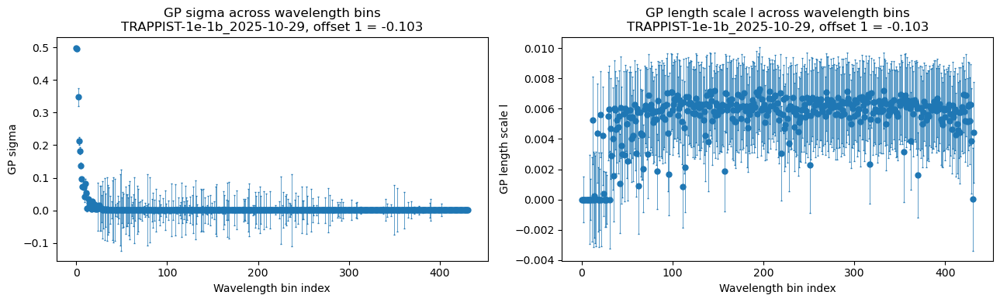

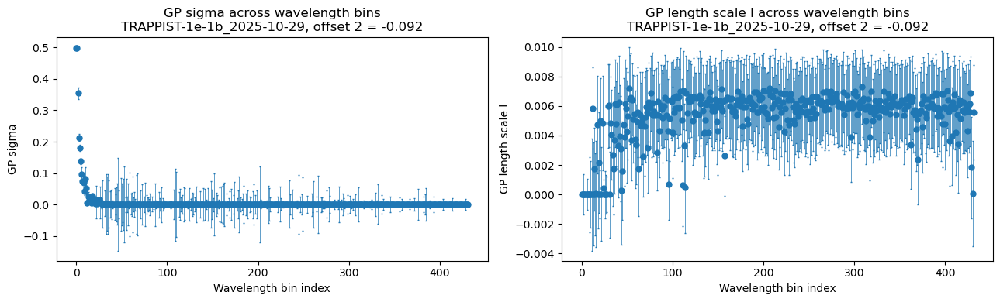

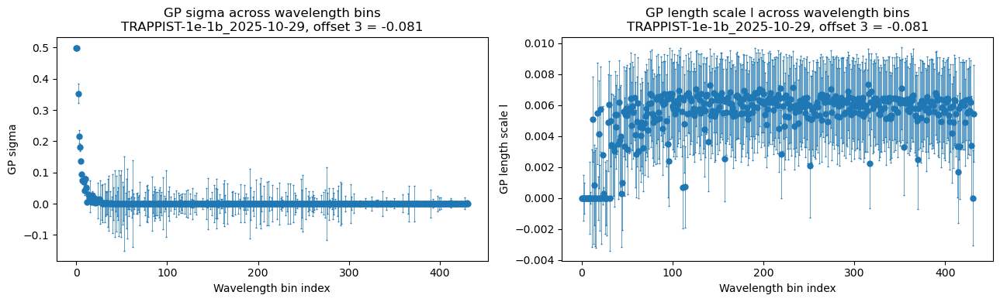

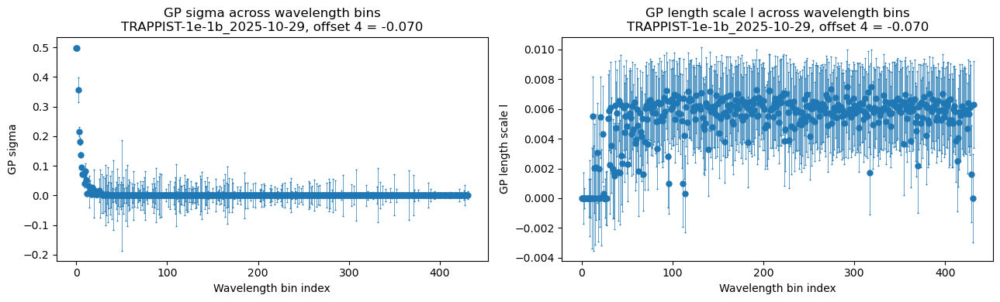

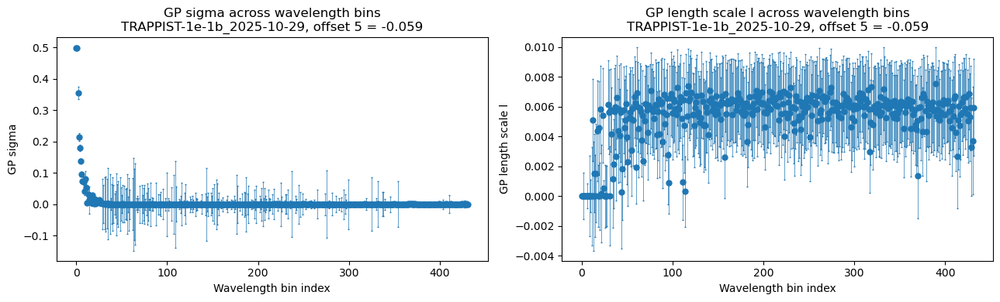

...

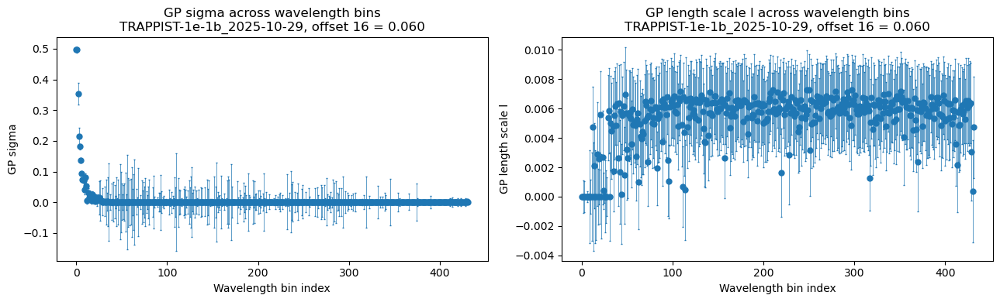

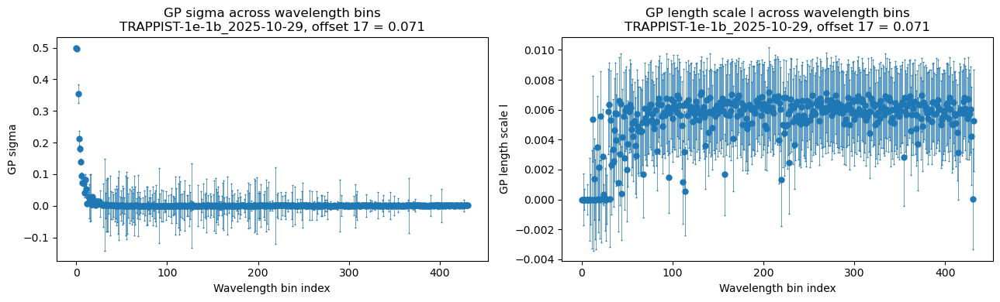

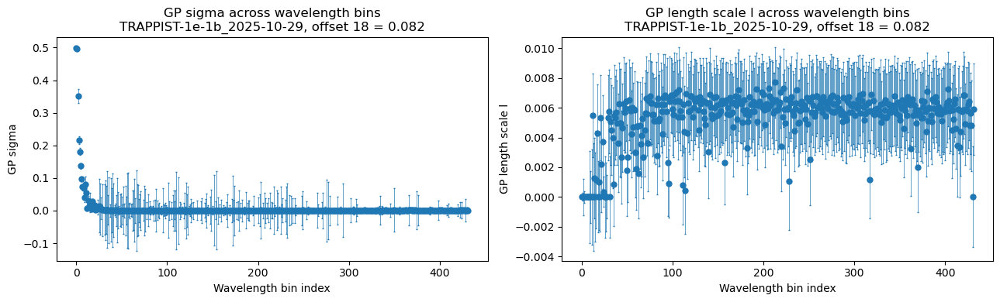

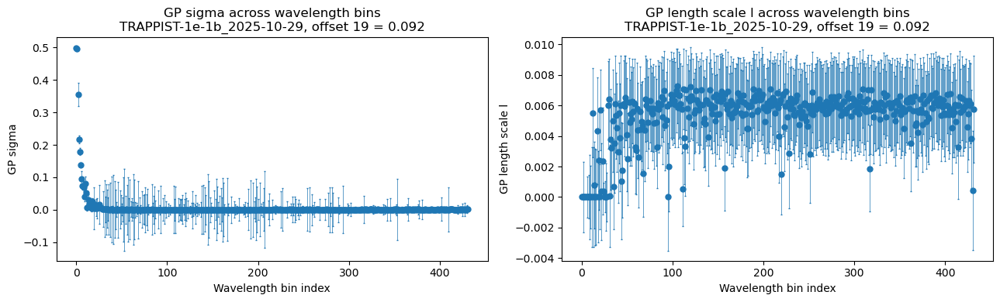

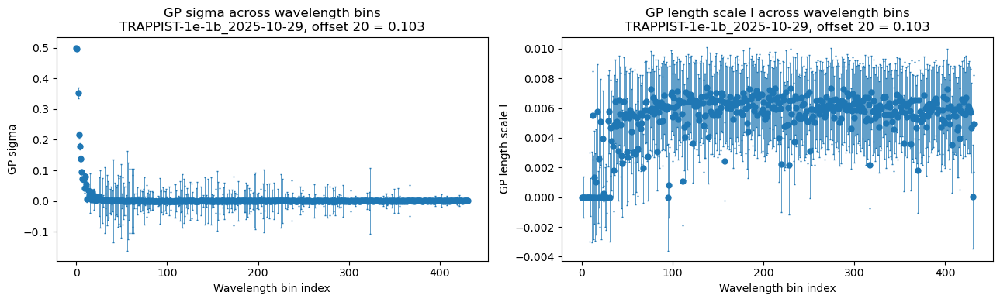

In [20]:
# plot gp hyperparameters across all wavelength bins for each offset

for idx, (key, d) in enumerate(data_dict_flares_new.items()):
    # Mask out the transit for binned data
    it_index = d['it_index'].copy()
    padding = 7
    transit_indices = np.where(it_index == 1)[0]

    for t_idx in transit_indices:
        start = max(0, t_idx - padding)
        end = min(len(it_index), t_idx + padding + 1)
        it_index[start:t_idx] = 1
        it_index[t_idx + 1:end] = 1

    bjd_binned_masked = d['bjd_binned'][it_index == 0]
    flux_binned_masked = d['flux_binned'][it_index == 0]
    white_binned_masked = d['white_binned'][it_index == 0]
    white_err_binned_masked = d['white_err_binned'][it_index == 0]
    flux_err_binned_masked = d['flux_err_binned'][it_index == 0]

    if key == "TRAPPIST-1e-1b_2025-10-29":
        # Find transit groups to identify 3rd and 4th transits
        transit_groups = []
        current_group = []
        for i, is_transit in enumerate(it_index):
            if is_transit:
                current_group.append(i)
            else:
                if current_group:
                    transit_groups.append(current_group)
                    current_group = []
        if current_group:  # Add last group if it exists
            transit_groups.append(current_group)

        if len(transit_groups) >= 4:
            # Get indices after 3rd transit and before 4th transit
            end_3rd_transit = transit_groups[2][-1]
            start_4th_transit = transit_groups[3][0]
            
            # Create mask for data between 3rd and 4th transits
            between_mask = np.arange(len(d['bjd_binned']))
            between_mask = (between_mask > end_3rd_transit) & (between_mask < start_4th_transit)
            # Apply both out-of-transit mask and between-transits mask
            final_mask = (it_index == 0) & between_mask     
            bjd_binned_masked = d['bjd_binned'][final_mask]
            flux_binned_masked = d['flux_binned'][final_mask]
            flux_err_binned_masked = d['flux_err_binned'][final_mask]
            white_binned_masked = d['white_binned'][final_mask]
            white_err_binned_masked = d['white_err_binned'][final_mask]
            
    for jdx,j in enumerate(offset_list):
        output_filename = f'outputs/mcmc_results_{key}_{j:.5f}_gp_feature.txt'

        # Load existing results
        data = np.loadtxt(output_filename, delimiter=',', skiprows=1)
        rp_fits = data[:, 0]
        rp_errs = data[:, 1]
        slope_fits = data[:, 2]
        slope_errs = data[:, 3]
        intercept_fits = data[:, 4]
        intercept_errs = data[:, 5]
        tpeak_fits = data[:, 6]
        tpeak_errs = data[:, 7]
        fwhm_fits = data[:, 8]
        fwhm_errs = data[:, 9]
        ampl_fits = data[:, 10]
        ampl_errs = data[:, 11]
        sigma_fits = data[:, 12]
        sigma_errs = data[:, 13]
        l_fits = data[:, 14]
        l_errs = data[:, 15]

        pl.figure(figsize=(13, 4))
        pl.subplot(1, 2, 1)
        pl.errorbar(np.arange(len(sigma_fits)), sigma_fits, yerr=sigma_errs, fmt='o', capsize=0.5, markersize=5, elinewidth=0.5)
        pl.xlabel('Wavelength bin index')
        pl.ylabel('GP sigma')
        pl.title(f'GP sigma across wavelength bins\n{key}, offset {jdx+1} = {j:.3f}')

        pl.subplot(1, 2, 2)
        pl.errorbar(np.arange(len(l_fits)), l_fits, yerr=l_errs, fmt='o',  capsize=0.5, markersize=5, elinewidth=0.5)
        pl.xlabel('Wavelength bin index')
        pl.ylabel('GP length scale l')
        pl.title(f'GP length scale l across wavelength bins\n{key}, offset {jdx+1} = {j:.3f}')

        pl.tight_layout()
        pl.show()
